In [1]:
using Pkg
Pkg.activate("/Users/alessiogiorlandino/Desktop/SAM/Project.toml")
Base.active_project()
# Resolve dependencies
Pkg.resolve()

import Rfam, Infernal, Logomaker, FASTX
using Optimisers: Adam
using EllipsisNotation: (..)
using FillArrays: Falses
import Makie, CairoMakie
using Makie: @colorant_str
import SamApp
using LinearAlgebra
using Statistics
using LaTeXStrings
using DelimitedFiles: readdlm, writedlm

using BioSequences: LongRNA, @rna_str
using Statistics: mean, std, cor
import JLD2

using Plots
default(fmt = :png)

import RestrictedBoltzmannMachines as RBMs
import CudaRBMs, CenteredRBMs
using CudaRBMs: gpu, cpu
using CenteredRBMs: CenteredRBM, center, uncenter, center_from_data!
using RestrictedBoltzmannMachines: initialize!, RBM, xReLU, Potts, pcd!, Binary, log_pseudolikelihood, free_energy, Gaussian
using RBMsAnnealedImportanceSampling: aise, raise, logmeanexp, logstdexp, logvarexp

import RestrictedBoltzmannMachines
using MiniLoggers: global_logger, MiniLogger
global_logger(MiniLogger());

  Activating project at `~/Desktop/SAM`


  No Changes to `~/Desktop/SAM/Project.toml`
  No Changes to `~/Desktop/SAM/Manifest.toml`


    CondaPkg Found dependencies: /Users/alessiogiorlandino/.julia/packages/Logomaker/DdglG/CondaPkg.toml


    CondaPkg Found dependencies: /Users/alessiogiorlandino/.julia/packages/PythonCall/dsECZ/CondaPkg.toml


    CondaPkg Dependencies already up to date


In [7]:
#=
cm = Infernal.cmfetch(Rfam.cm(), "RF00162")
natural_seed_stk = Infernal.esl_afetch(Rfam.seed(), "RF00162");
natural_seed_afa = Infernal.esl_reformat("afa", natural_seed_stk.out);
natural_seed_ids = FASTX.identifier.(FASTX.FASTA.Reader(open(natural_seed_afa.out)));

# Consensus secondary structure in WUSS format
seed_wuss = SamApp.stockholm_ss(natural_seed_stk.out)
seed_match_positions = findall(c -> c ≠ '.' && c ≠ '~', seed_wuss);

natural_hits_afa = Infernal.cmalign(Infernal.cmfetch(Rfam.cm(), "RF00162").out, Rfam.fasta_file("RF00162"); outformat="afa");
natural_hits_ids = FASTX.identifier.(FASTX.FASTA.Reader(open(natural_hits_afa.out)));

natural_seed_sequences_matchonly = map(FASTX.FASTA.Reader(open(natural_seed_afa.out))) do record
    FASTX.sequence(record)[seed_match_positions]
end

natural_hits_sequences_matchonly = map(FASTX.FASTA.Reader(open(natural_hits_afa.out))) do record
    filter(c -> !islowercase(c) && c ≠ '.', FASTX.sequence(record))
end

@assert only(unique(length.(natural_seed_sequences_matchonly))) == length(seed_match_positions) == 108
@assert only(unique(length.(natural_hits_sequences_matchonly))) == length(seed_match_positions) == 108

data_hits = SamApp.onehot(LongRNA{4}.(natural_hits_sequences_matchonly));
=#

# Splitting Training/Test 

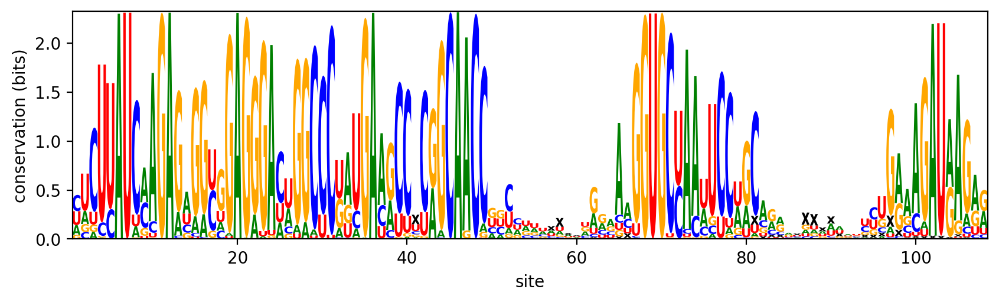

In [2]:
using CSV
using DataFrames
MSA_df=SamApp.rf00162_hits_taxonomy()
data_hits = SamApp.onehot(LongRNA{4}.(MSA_df.sequence))
SamApp.seqlogo_entropic(reshape(mean(data_hits; dims=3), 5, 108)).fig

In [3]:
sp_taxonomy = split.(MSA_df[:,"taxonomy"], "; ")
phylum = fill("other", length(sp_taxonomy))
domain = fill("Bacteria", length(sp_taxonomy))
subphylum = fill("other", length(sp_taxonomy))

for i in 1:length(sp_taxonomy)
    if length(sp_taxonomy[i]) >= 3
        domain[i] = sp_taxonomy[i][1]
        phylum[i] = sp_taxonomy[i][2]
        subphylum[i] = sp_taxonomy[i][2]*";"*sp_taxonomy[i][3]
    elseif length(sp_taxonomy[i]) == 2
        domain[i] = sp_taxonomy[i][1]
        phylum[i] = sp_taxonomy[i][2]
    elseif length(sp_taxonomy[i]) == 1
        domain[i] = sp_taxonomy[i][1]
    end
end

MSA_df[!,:domain] = domain
MSA_df[!,:phylum] = phylum
MSA_df[!,:subphylum] = subphylum


subphyla_counts = sort!(combine(groupby(MSA_df, :subphylum), :phylum => length => :count), :count, rev=true)

Row,subphylum,count
,String,Int64
1,Bacillota;Bacilli,2382
2,Bacillota;Clostridia,1013
3,Bacteroidota;Flavobacteriia,361
4,other,319
5,Bacteroidota;Cytophagia,246
6,Actinomycetota;Streptomycetales,203
7,Actinomycetota;Micrococcales,170
8,Bacillota;Negativicutes,157
9,Bacteroidota;Sphingobacteriia,149


## Train data

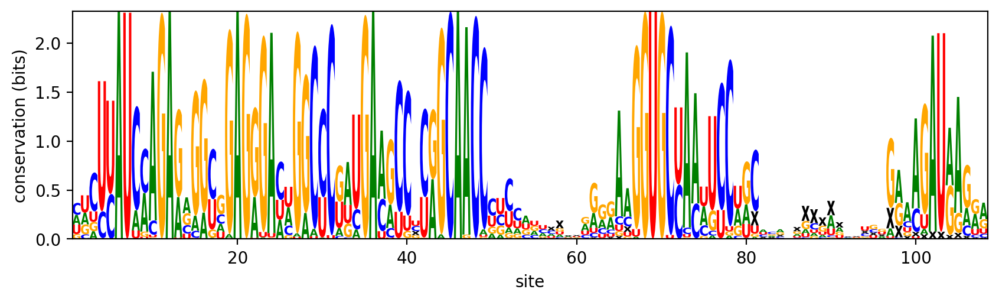

In [136]:
id_Bacilli = MSA_df.id[MSA_df.subphylum .== "Bacillota;Bacilli"]
id_Clostridia = MSA_df.id[MSA_df.subphylum .== "Bacillota;Clostridia"]
id_Flavobacteriia = MSA_df.id[MSA_df.subphylum .== "Bacteroidota;Flavobacteriia"]
id_Cytophagia= MSA_df.id[MSA_df.subphylum .== "Bacteroidota;Cytophagia"]
id_Streptomycetales = MSA_df.id[MSA_df.subphylum .== "Actinomycetota;Streptomycetales"]
id_Micrococcales = MSA_df.id[MSA_df.subphylum .== "Actinomycetota;Micrococcales"]

subphylum_ids = [id_Bacilli, id_Clostridia, id_Flavobacteriia, id_Cytophagia, id_Streptomycetales, id_Micrococcales]

using StatsBase: sample
N_samples = 150
train_id = []
for id_collection in subphylum_ids
    append!(train_id, sample(id_collection, N_samples, replace=false))
end

train_df = filter(row -> row["id"] in train_id, MSA_df)

train_data = SamApp.onehot(LongRNA{4}.(train_df.sequence));

SamApp.seqlogo_entropic(reshape(mean(train_data; dims=3), 5, 108)).fig

## Test Data

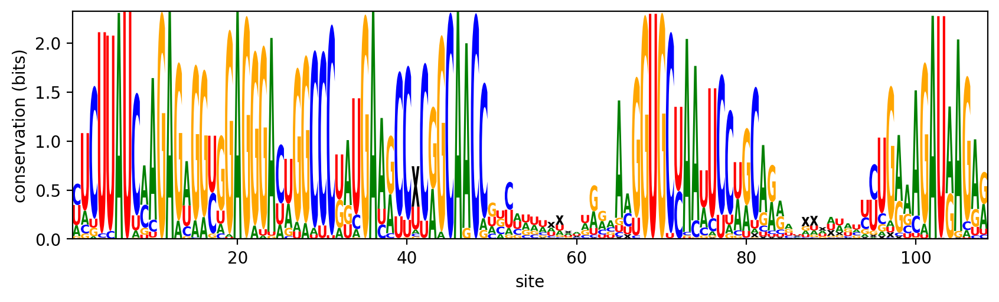

In [137]:
test_id = []
for id_collection in subphylum_ids
    append!(test_id, id_collection)
end
test_id = setdiff(test_id, train_id)
test_df = filter(row -> row["id"] in test_id, MSA_df)

test_data = SamApp.onehot(LongRNA{4}.(test_df.sequence));

SamApp.seqlogo_entropic(reshape(mean(test_data; dims=3), 5, 108)).fig

# Data Visualization

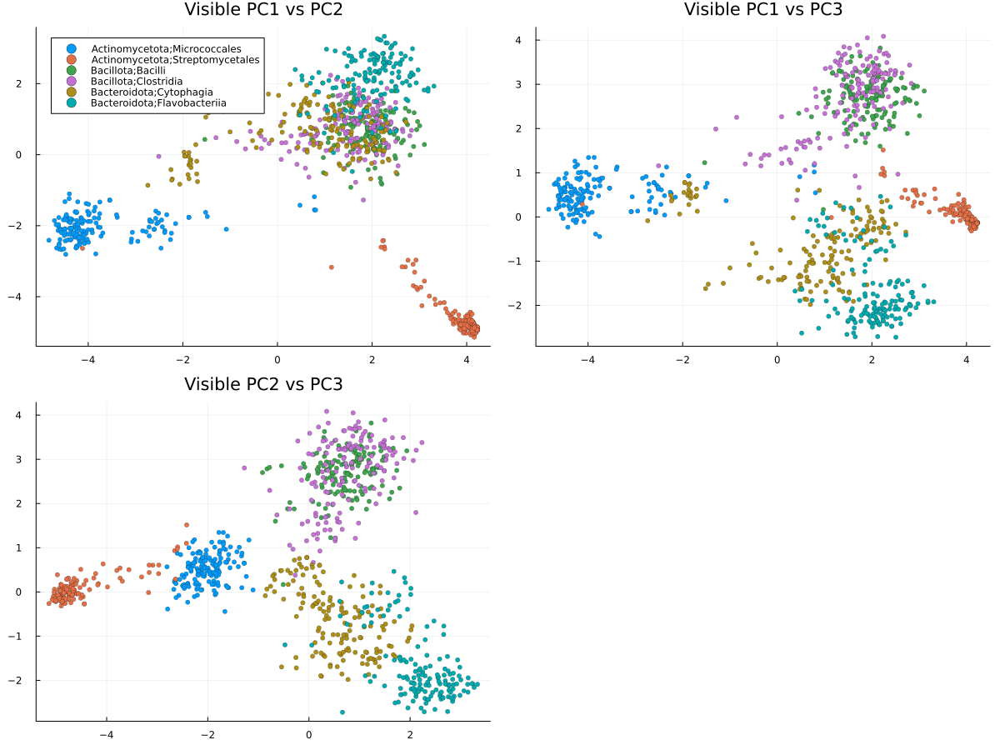

In [6]:
function PCA(data)
    data_shape = size(data)
    cov_matrix = cov(data, dims=2)
    cov_eigenval = eigvals(cov_matrix)
    expl_ratio = cov_eigenval/sum(cov_eigenval)
    ort_trasf = eigvecs(cov_matrix)
    return transpose(ort_trasf)*data, expl_ratio,  ort_trasf
end
    

data_shape = size(train_data)


v_data_rot, expl_ratio_v, O_v = PCA(reshape(train_data, (data_shape[1]*data_shape[2], data_shape[3])))

pca_v = [v_data_rot[end-i, :] for i in 0:3]


using DataFrames, StatsPlots
df_v =  DataFrame(PC1=pca_v[1], PC2=pca_v[2], PC3=pca_v[3], PC4=pca_v[4], Label=train_df.subphylum)

p1 = scatter(df_v.PC1 , df_v.PC2, markerstrokewidth=0.1, ms=3, group=df_v.Label, title="Visible PC1 vs PC2")
p2 = scatter(df_v.PC1 , markerstrokewidth=0.1, ms=3, df_v.PC3, group=df_v.Label, title="Visible PC1 vs PC3", legend=false)
p3 = scatter(df_v.PC2, markerstrokewidth=0.1, ms=3, df_v.PC3, group=df_v.Label, title="Visible PC2 vs PC3", legend=false)

plot(p1, p2, p3, size=(1200,900))


# Training

In [30]:
function callback1(; rbm, iter, kw...)
    if iszero(iter % 50) || iter==1
        Δt = @elapsed (lpl = mean(log_pseudolikelihood(rbm, data)))
        write(logfile, "$iter $lpl \n")
        if iszero(iter % 1000)
            @info iter lpl Δt
        end
    end
end

function callback(; rbm, iter, kw...)
    if iszero(iter % 100) || iter==1
        _, s, _ = svd(rbm.w)
        Δt = @elapsed (lpl = mean(log_pseudolikelihood(rbm, data)))
        append!(s, iter)
        writedlm(logfile_singval, s')
        write(logfile, "$iter $lpl \n")
        if iszero(iter % 1000)
            @info iter lpl Δt
        end
    end

end

callback (generic function with 1 method)

### RBM1

In [7]:
data_shape=size(train_data)

(5, 108, 900)

[2023-06-21 10:38:48] Info: 1000 lpl = -0.387639297526954, Δt = 0.081828542


[2023-06-21 10:39:55] Info: 2000 lpl = -0.2952517157198658, Δt = 0.054431416


[2023-06-21 10:41:22] Info: 3000 lpl = -0.28704240962320304, Δt = 0.120344292


[2023-06-21 10:43:07] Info: 4000 lpl = -0.27441991688726414, Δt = 0.087431375


[2023-06-21 10:44:47] Info: 5000 lpl = -0.25012092419790344, Δt = 0.085590875


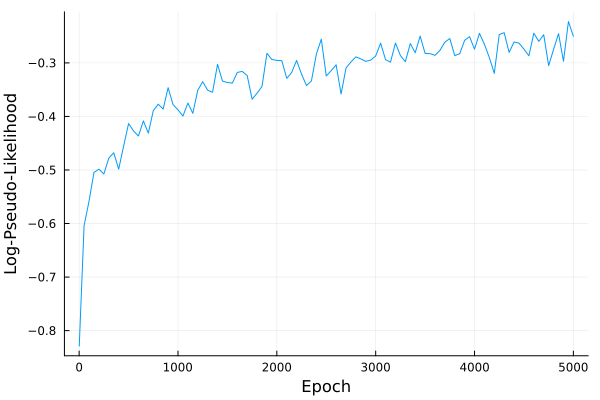

In [31]:
logfile = open("./Log/Stacked1.txt", "w+")

data = train_data
n_hidden1 = 512
rbm1 = center(RBM(Potts((5, 108)), Binary((n_hidden1,)), zeros(5, 108, n_hidden1)));
initialize!(rbm1, data);
pcd!(
    rbm1, data; 
    batchsize=100, iters=5000, steps=10, optim=Adam(1f-3), l2_weights=1f-2,
    vm=data[.., rand(1:size(data)[end], 256)], callback=callback1
);

close(logfile)

logdata = readdlm("./Log/Stacked1.txt")
iter= logdata[:, 1]
lpl = logdata[:, 2]
plot(iter, lpl, legend=false)
xlabel!("Epoch")
ylabel!("Log-Pseudo-Likelihood")

### RBM2

In [32]:
hidden_data1 = zeros(n_hidden1, data_shape[3])
for i in 1:data_shape[3]
    hidden_data1[:,i]=RestrictedBoltzmannMachines.sample_h_from_v(rbm1, train_data[:,:,i]) 
end

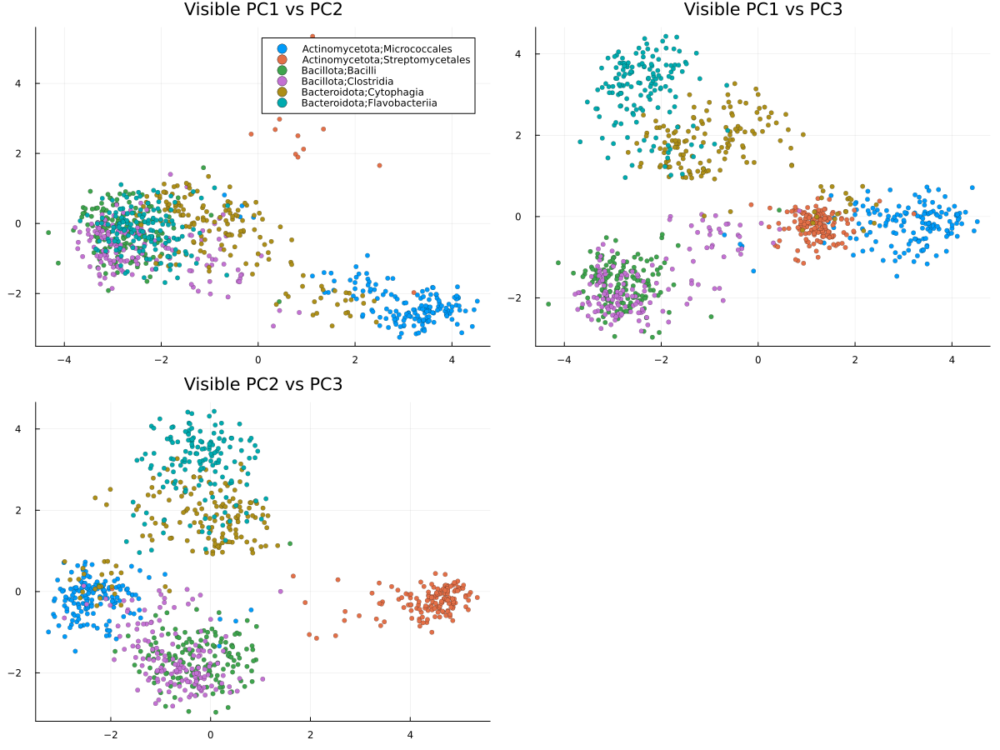

In [33]:

data_rot, expl_ratio, O = PCA(hidden_data1)

pca_1 = [data_rot[end-i, :] for i in 0:3]


using DataFrames, StatsPlots
df_1 =  DataFrame(PC1=pca_1[1], PC2=pca_1[2], PC3=pca_1[3], PC4=pca_1[4], Label=train_df.subphylum)

p1 = scatter(df_1.PC1 , df_1.PC2, markerstrokewidth=0.1, ms=3, group=df_1.Label, title="Visible PC1 vs PC2")
p2 = scatter(df_1.PC1 , markerstrokewidth=0.1, ms=3, df_1.PC3, group=df_1.Label, title="Visible PC1 vs PC3", legend=false)
p3 = scatter(df_1.PC2, markerstrokewidth=0.1, ms=3, df_1.PC3, group=df_1.Label, title="Visible PC2 vs PC3", legend=false)

plot(p1, p2, p3, size=(1200,900))


[2023-06-21 11:01:52] Info: 1000 lpl = -0.5512203653873792, Δt = 0.011435875


[2023-06-21 11:02:07] Info: 2000 lpl = -0.45283677332783195, Δt = 0.012437125


[2023-06-21 11:02:26] Info: 3000 lpl = -0.4219247260602751, Δt = 0.014155667


[2023-06-21 11:02:42] Info: 4000 lpl = -0.36423217236206684, Δt = 0.0139265


[2023-06-21 11:02:58] Info: 5000 lpl = -0.3227954535057154, Δt = 0.014934875


[2023-06-21 11:03:14] Info: 6000 lpl = -0.31536013440778216, Δt = 0.014196791


[2023-06-21 11:03:29] Info: 7000 lpl = -0.3133693386656551, Δt = 0.014411875


[2023-06-21 11:03:45] Info: 8000 lpl = -0.27644556527242686, Δt = 0.01442575


[2023-06-21 11:04:01] Info: 9000 lpl = -0.3230578539873648, Δt = 0.014167667


[2023-06-21 11:04:16] Info: 10000 lpl = -0.27443729325124705, Δt = 0.014562291


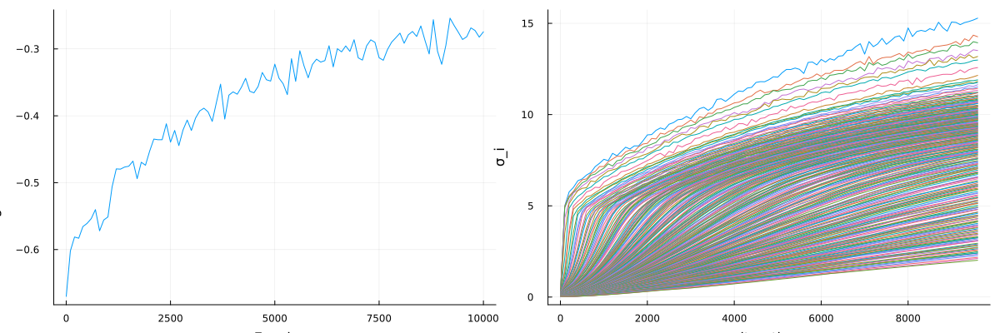

In [52]:
logfile = open("./Log/Stacked2.txt", "w+")
logfile_singval = open("./Log/train_singval.txt", "w+")

n_hidden2 = 256
data = hidden_data1

rbm2 = center(RBM(Binary((n_hidden1,)), Binary((n_hidden2,)), zeros(n_hidden1, n_hidden2)));
initialize!(rbm2, data);

pcd!(
    rbm2, data; 
    batchsize=100, iters=10000, steps=10, optim=Adam(1f-3), l2_weights=0.001,
    vm=hidden_data1[.., rand(1:size(hidden_data1)[end], 100)], callback=callback
);

close(logfile)

logdata = readdlm("./Log/Stacked2.txt")
iter= logdata[:, 1]
lpl = logdata[:, 2]
p1=plot(iter, lpl, legend=false)
xlabel!(p1,"Epoch")
ylabel!(p1,"Log-Pseudo-Likelihood") 

singval_data = readdlm("./Log/train_singval.txt")
p2=plot(singval_data[:,end], singval_data[:, 1:end-1], legend=false)
xlabel!(p2,"iteration")
ylabel!(p2,"σ_i")
plot(p1,p2 , size=(1200,400))

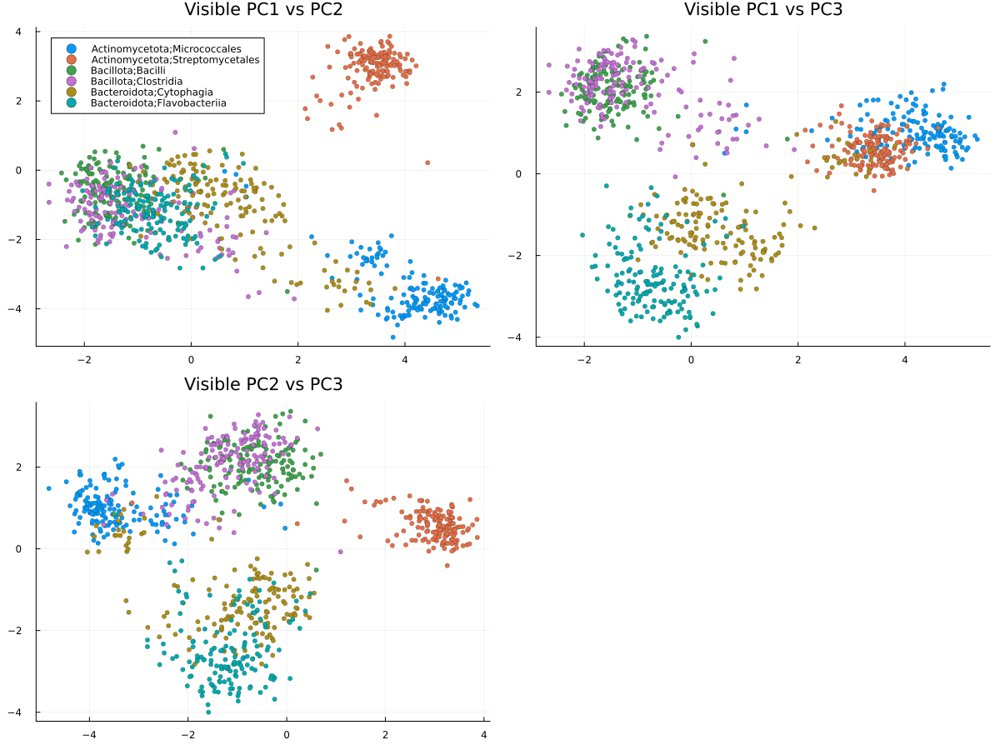

In [53]:
hidden_data2 = zeros(n_hidden2, data_shape[3])
for i in 1:data_shape[3]
    hidden_data2[:,i]=RestrictedBoltzmannMachines.sample_h_from_v(rbm2, hidden_data1[:,i]) 
end


data_rot, expl_ratio, O = PCA(hidden_data2)

pca_2 = [data_rot[end-i, :] for i in 0:3]


using DataFrames, StatsPlots
df_2 =  DataFrame(PC1=pca_2[1], PC2=pca_2[2], PC3=pca_2[3], PC4=pca_2[4], Label=train_df.subphylum)

p1 = scatter(df_2.PC1 , df_2.PC2, markerstrokewidth=0.1, ms=3, group=df_2.Label, title="Visible PC1 vs PC2")
p2 = scatter(df_2.PC1 , markerstrokewidth=0.1, ms=3, df_2.PC3, group=df_2.Label, title="Visible PC1 vs PC3", legend=false)
p3 = scatter(df_2.PC2, markerstrokewidth=0.1, ms=3, df_2.PC3, group=df_2.Label, title="Visible PC2 vs PC3", legend=false)

plot(p1, p2, p3, size=(1200,900))


### RBM 3

[2023-06-21 11:20:03] Info: 1000 lpl = -0.5057148392485689, Δt = 0.00507675


[2023-06-21 11:20:10] Info: 2000 lpl = -0.46832077958486656, Δt = 0.00508575


[2023-06-21 11:20:17] Info: 3000 lpl = -0.4412686307654307, Δt = 0.006423167


[2023-06-21 11:20:24] Info: 4000 lpl = -0.4148952347646585, Δt = 0.005663791


[2023-06-21 11:20:30] Info: 5000 lpl = -0.37957877168389376, Δt = 0.005622375


[2023-06-21 11:20:37] Info: 6000 lpl = -0.3883365159949459, Δt = 0.005846


[2023-06-21 11:20:47] Info: 7000 lpl = -0.38269469732468697, Δt = 0.007834459


[2023-06-21 11:20:55] Info: 8000 lpl = -0.36405238817366825, Δt = 0.007672125


[2023-06-21 11:21:04] Info: 9000 lpl = -0.3691410919231927, Δt = 0.006865875


[2023-06-21 11:21:10] Info: 10000 lpl = -0.3616019905539881, Δt = 0.006155084


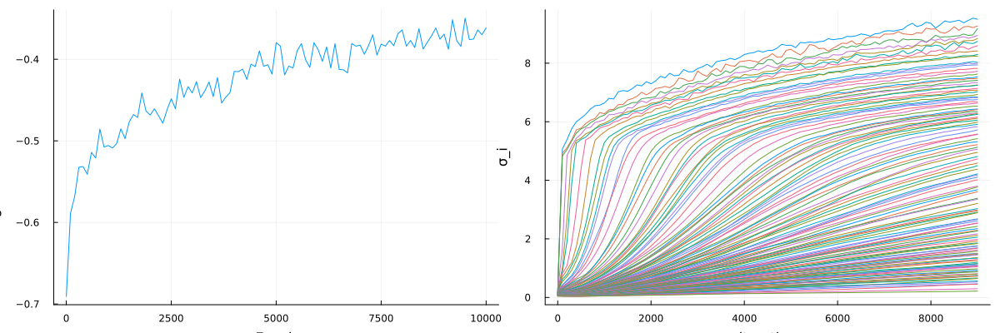

In [59]:
logfile = open("./Log/Stacked3.txt", "w+")
logfile_singval = open("./Log/train_singval.txt", "w+")

n_hidden3 = 128
data = hidden_data2

rbm3= center(RBM(Binary((n_hidden2,)), Binary((n_hidden3,)), zeros(n_hidden2, n_hidden3)));
initialize!(rbm3, data);

pcd!(
    rbm3, data; 
    batchsize=100, iters=10000, steps=10, optim=Adam(1f-3), l2_weights=0.005,
    callback=callback
);

close(logfile)

logdata = readdlm("./Log/Stacked3.txt")
iter= logdata[:, 1]
lpl = logdata[:, 2]
p1=plot(iter, lpl, legend=false)
xlabel!(p1,"Epoch")
ylabel!(p1,"Log-Pseudo-Likelihood") 

singval_data = readdlm("./Log/train_singval.txt")
p2=plot(singval_data[:,end], singval_data[:, 1:end-1], legend=false)
xlabel!(p2,"iteration")
ylabel!(p2,"σ_i")
plot(p1,p2 , size=(1200,400))

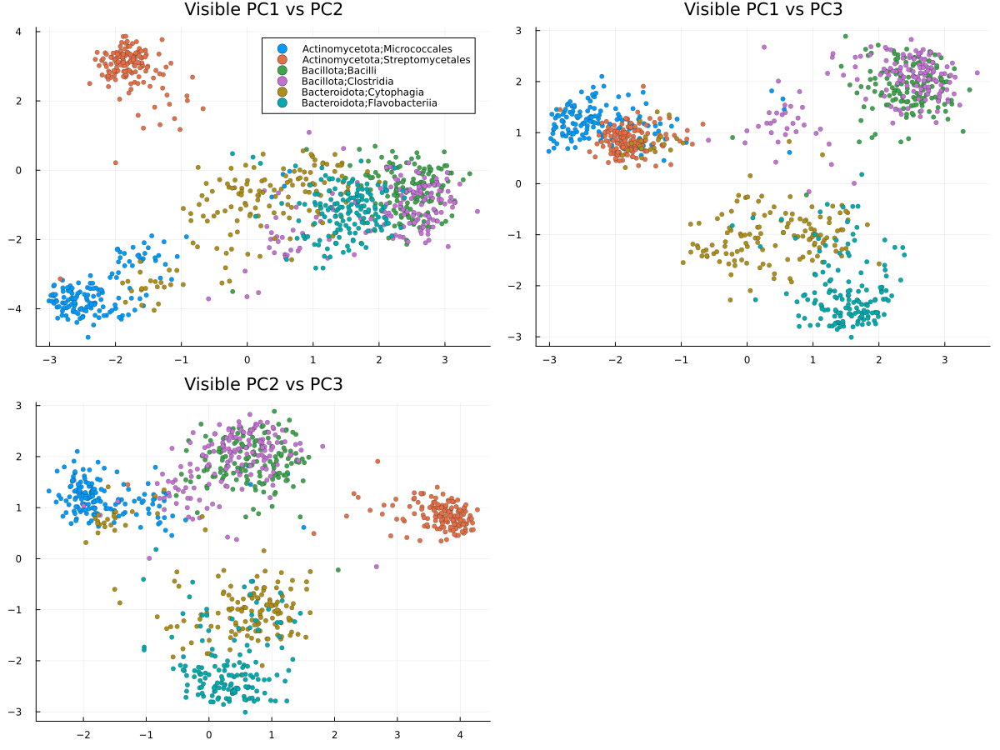

In [61]:
hidden_data3 = zeros(n_hidden3, data_shape[3])
for i in 1:data_shape[3]
    hidden_data3[:,i]=RestrictedBoltzmannMachines.sample_h_from_v(rbm3, hidden_data2[:,i]) 
end

data_rot, expl_ratio, O = PCA(hidden_data3)

pca_3 = [data_rot[end-i, :] for i in 0:3]


using DataFrames, StatsPlots
df_3 =  DataFrame(PC1=pca_3[1], PC2=pca_3[2], PC3=pca_3[3], PC4=pca_3[4], Label=train_df.subphylum)

p1 = scatter(df_3.PC1 , df_2.PC2, markerstrokewidth=0.1, ms=3, group=df_3.Label, title="Visible PC1 vs PC2")
p2 = scatter(df_3.PC1 , markerstrokewidth=0.1, ms=3, df_3.PC3, group=df_3.Label, title="Visible PC1 vs PC3", legend=false)
p3 = scatter(df_3.PC2, markerstrokewidth=0.1, ms=3, df_3.PC3, group=df_3.Label, title="Visible PC2 vs PC3", legend=false)

plot(p1, p2, p3, size=(1200,900))


[2023-06-21 11:23:22] Info: 1000 lpl = -0.4376756839942139, Δt = 0.002642875


[2023-06-21 11:23:25] Info: 2000 lpl = -0.397176777968296, Δt = 0.002552708


[2023-06-21 11:23:28] Info: 3000 lpl = -0.38535135460236697, Δt = 0.002555875


[2023-06-21 11:23:31] Info: 4000 lpl = -0.38634029403466386, Δt = 0.002839791


[2023-06-21 11:23:35] Info: 5000 lpl = -0.37793278618489556, Δt = 0.002832375


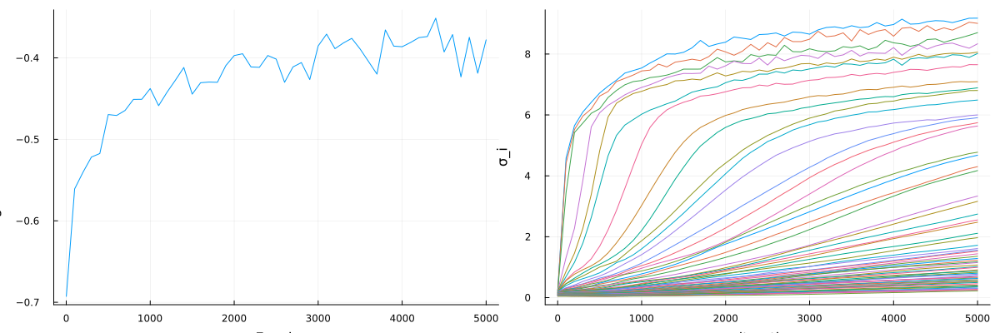

In [64]:
logfile = open("./Log/Stacked4.txt", "w+")
logfile_singval = open("./Log/train_singval.txt", "w+")


n_hidden4 = 64
data = hidden_data3

rbm4 = center(RBM(Binary((n_hidden3,)), Binary((n_hidden4,)), zeros(n_hidden3, n_hidden4)));
initialize!(rbm4, data);

pcd!(
    rbm4, data; 
    batchsize=100, iters=5000, steps=10, optim=Adam(1f-3), l2_weights=0.005,
    callback
);

close(logfile)
close(logfile_singval)

logdata = readdlm("./Log/Stacked4.txt")
iter= logdata[:, 1]
lpl = logdata[:, 2]
p1=plot(iter, lpl, legend=false)
xlabel!("Epoch")
ylabel!("Log-Pseudo-Likelihood")
singval_data = readdlm("./Log/train_singval.txt")
p2=plot(singval_data[:,end], singval_data[:, 1:end-1], legend=false)
xlabel!(p2,"iteration")
ylabel!(p2,"σ_i")
plot(p1,p2 , size=(1200,400))

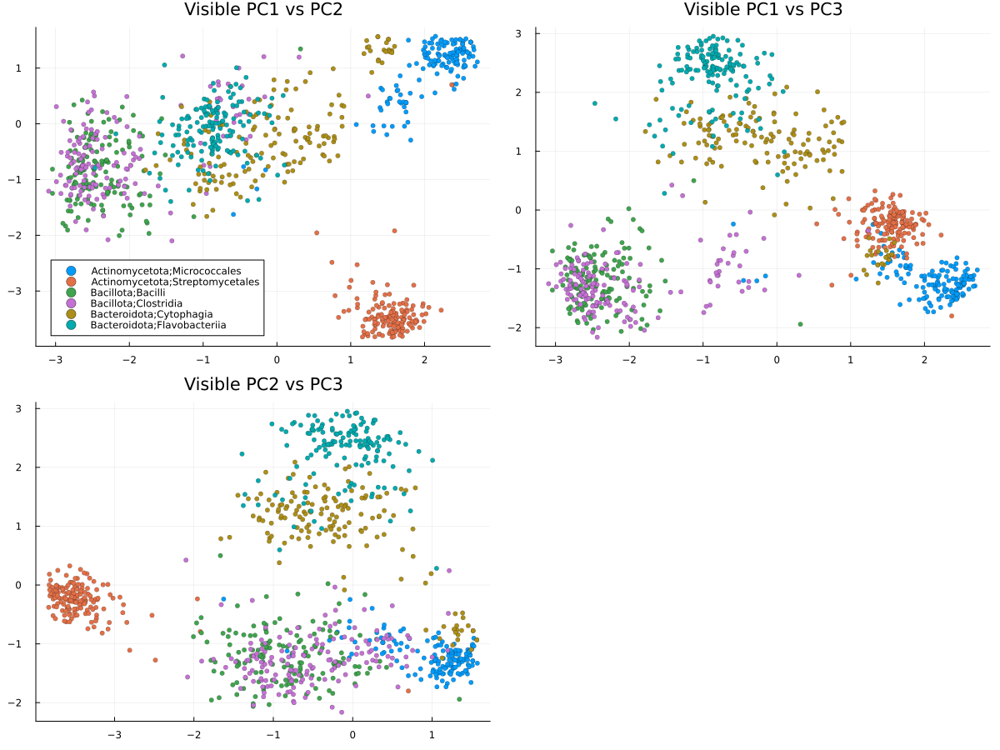

In [65]:
hidden_data4 = zeros(n_hidden4, data_shape[3])
for i in 1:data_shape[3]
    hidden_data4[:,i]=RestrictedBoltzmannMachines.sample_h_from_v(rbm4, hidden_data3[:,i]) 
end


data_rot, expl_ratio, O = PCA(hidden_data4)

pca_4 = [data_rot[end-i, :] for i in 0:3]


using DataFrames, StatsPlots
df_4 =  DataFrame(PC1=pca_4[1], PC2=pca_4[2], PC3=pca_4[3], PC4=pca_4[4], Label=train_df.subphylum)

p1 = scatter(df_4.PC1 , df_4.PC2, markerstrokewidth=0.1, ms=3, group=df_4.Label, title="Visible PC1 vs PC2")
p2 = scatter(df_4.PC1 , markerstrokewidth=0.1, ms=3, df_4.PC3, group=df_4.Label, title="Visible PC1 vs PC3", legend=false)
p3 = scatter(df_4.PC2, markerstrokewidth=0.1, ms=3, df_4.PC3, group=df_4.Label, title="Visible PC2 vs PC3", legend=false)

plot(p1, p2, p3, size=(1200,900))


[2023-06-21 11:25:30] Info: 1000 lpl = -0.33559091678056513, Δt = 0.001499167


[2023-06-21 11:25:31] Info: 2000 lpl = -0.3419031785223719, Δt = 0.001800167


[2023-06-21 11:25:33] Info: 3000 lpl = -0.30617754988462753, Δt = 0.00148075


[2023-06-21 11:25:34] Info: 4000 lpl = -0.32147150964070453, Δt = 0.001442


[2023-06-21 11:25:36] Info: 5000 lpl = -0.2901465994636964, Δt = 0.00137825


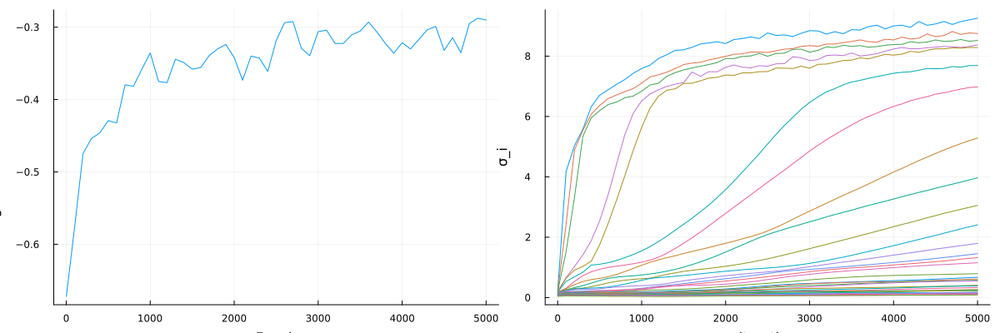

In [68]:
logfile = open("./Log/Stacked5.txt", "w+")
logfile_singval = open("./Log/train_singval.txt", "w+")


n_hidden5 = 32
data = hidden_data4

rbm5 = center(RBM(Binary((n_hidden4,)), Binary((n_hidden5,)), zeros(n_hidden4, n_hidden5)));
initialize!(rbm5, data);

pcd!(
    rbm5, data; 
    batchsize=100, iters=5000, steps=10, optim=Adam(1f-3), l2_weights=0.005,
    callback
);

close(logfile)
close(logfile_singval)

logdata = readdlm("./Log/Stacked5.txt")
iter= logdata[:, 1]
lpl = logdata[:, 2]
p1=plot(iter, lpl, legend=false)
xlabel!("Epoch")
ylabel!("Log-Pseudo-Likelihood")
singval_data = readdlm("./Log/train_singval.txt")
p2=plot(singval_data[:,end], singval_data[:, 1:end-1], legend=false)
xlabel!(p2,"iteration")
ylabel!(p2,"σ_i")
plot(p1,p2 , size=(1200,400))

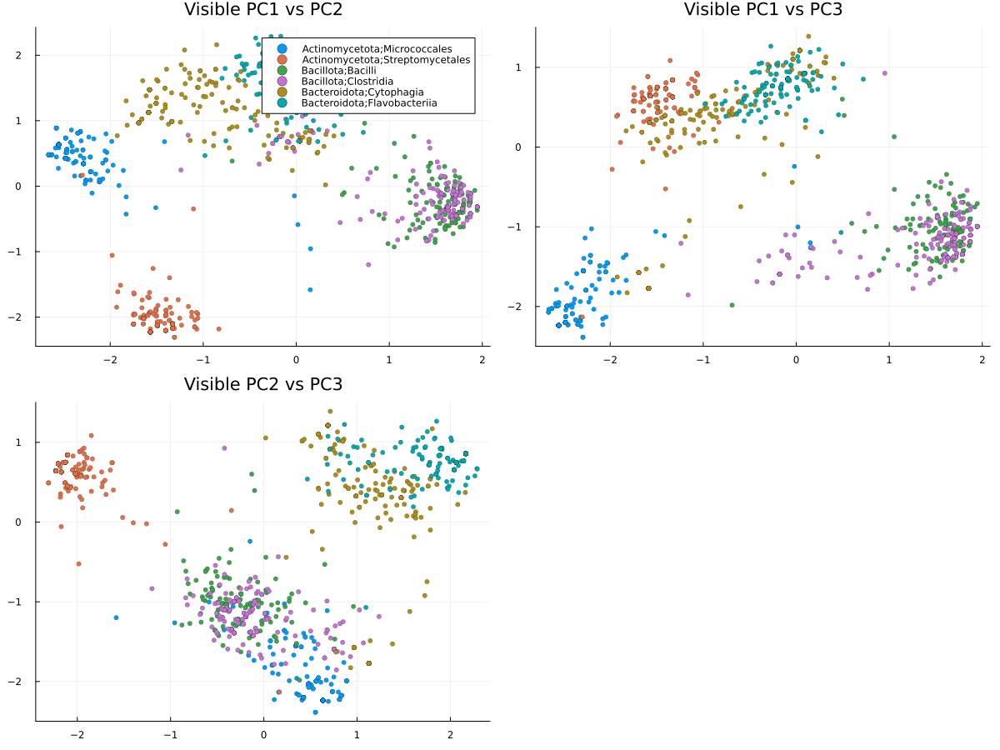

In [69]:
hidden_data5 = zeros(n_hidden5, data_shape[3])
for i in 1:data_shape[3]
    hidden_data5[:,i]=RestrictedBoltzmannMachines.sample_h_from_v(rbm5, hidden_data4[:,i]) 
end


data_rot, expl_ratio, O = PCA(hidden_data5)

pca_5 = [data_rot[end-i, :] for i in 0:3]


using DataFrames, StatsPlots
df_5 =  DataFrame(PC1=pca_5[1], PC2=pca_5[2], PC3=pca_5[3], PC4=pca_5[4], Label=train_df.subphylum)

p1 = scatter(df_5.PC1 , df_5.PC2, markerstrokewidth=0.1, ms=3, group=df_5.Label, title="Visible PC1 vs PC2")
p2 = scatter(df_5.PC1 , markerstrokewidth=0.1, ms=3, df_5.PC3, group=df_5.Label, title="Visible PC1 vs PC3", legend=false)
p3 = scatter(df_5.PC2, markerstrokewidth=0.1, ms=3, df_5.PC3, group=df_5.Label, title="Visible PC2 vs PC3", legend=false)

plot(p1, p2, p3, size=(1200,900))


[2023-06-21 11:26:01] Info: 1000 lpl = -0.3659801630573047, Δt = 0.000599208


[2023-06-21 11:26:02] Info: 2000 lpl = -0.33500768707466466, Δt = 0.000395334


[2023-06-21 11:26:03] Info: 3000 lpl = -0.3165180214357722, Δt = 0.000507875


[2023-06-21 11:26:03] Info: 4000 lpl = -0.2610291534529757, Δt = 0.000322625


[2023-06-21 11:26:04] Info: 5000 lpl = -0.29273674337765254, Δt = 0.000366625


[2023-06-21 11:26:05] Info: 6000 lpl = -0.25385751348340396, Δt = 0.0003245


[2023-06-21 11:26:05] Info: 7000 lpl = -0.279770637725914, Δt = 0.000330917


[2023-06-21 11:26:06] Info: 8000 lpl = -0.26687234471555543, Δt = 0.000401333


[2023-06-21 11:26:07] Info: 9000 lpl = -0.2548202377303825, Δt = 0.000330459


[2023-06-21 11:26:07] Info: 10000 lpl = -0.22168950572627377, Δt = 0.0003955


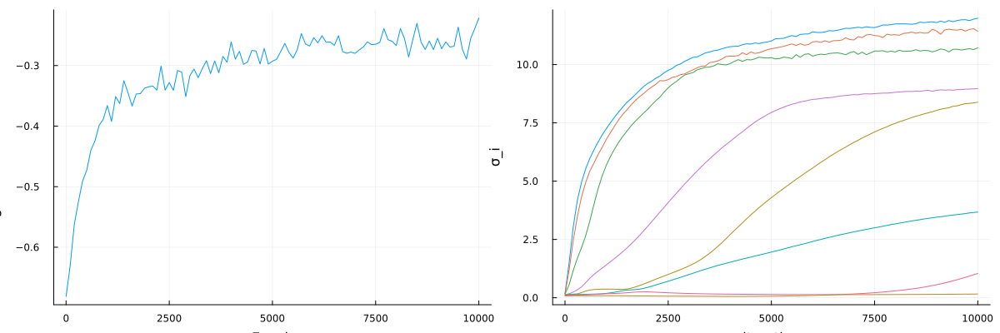

In [70]:
logfile = open("./Log/Stacked6.txt", "w+")
logfile_singval = open("./Log/train_singval.txt", "w+")


n_hidden6 = 8
data = hidden_data5

rbm6 = center(RBM(Binary((n_hidden5,)), Binary((n_hidden6,)), zeros(n_hidden5, n_hidden6)));
initialize!(rbm6, data);

pcd!(
    rbm6, data; 
    batchsize=100, iters=10000, steps=10, optim=Adam(1f-3), l2_weights=0.005,
    callback
);

close(logfile)
close(logfile_singval)

logdata = readdlm("./Log/Stacked6.txt")
iter= logdata[:, 1]
lpl = logdata[:, 2]
p1=plot(iter, lpl, legend=false)
xlabel!("Epoch")
ylabel!("Log-Pseudo-Likelihood")
singval_data = readdlm("./Log/train_singval.txt")
p2=plot(singval_data[:,end], singval_data[:, 1:end-1], legend=false)
xlabel!(p2,"iteration")
ylabel!(p2,"σ_i")
plot(p1,p2 , size=(1200,400))

In [71]:
using JLD2
train = 1
if train == 0 
    jldsave("rbms.jld2"; rbm1, rbm2, rbm3, rbm4, rbm5, rbm6)
else 
    @load "rbms.jld2"
    n_hidden1 = 512
    n_hidden2 = 256
    n_hidden3 = 128
    n_hidden4 = 64
    n_hidden5 = 32
    n_hidden6 = 8
    hidden_data1= zeros(n_hidden1, data_shape[3])
    hidden_data2 = zeros(n_hidden2, data_shape[3])    
    hidden_data3 = zeros(n_hidden3, data_shape[3])
    hidden_data4 = zeros(n_hidden4, data_shape[3])
    hidden_data5 = zeros(n_hidden5, data_shape[3])
    hidden_data6 = zeros(n_hidden6, data_shape[3])
    for i in 1:data_shape[3]
        hidden_data1[:,i] = RestrictedBoltzmannMachines.sample_h_from_v(rbm1, data_hits[:,:,i]) 
    end
    for i in 1:data_shape[3]
        hidden_data2[:,i] = RestrictedBoltzmannMachines.sample_h_from_v(rbm2, hidden_data1[:,i]) 
    end
    for i in 1:data_shape[3]
        hidden_data3[:,i] = RestrictedBoltzmannMachines.sample_h_from_v(rbm3, hidden_data2[:,i]) 
    end
    for i in 1:data_shape[3]
        hidden_data4[:,i] = RestrictedBoltzmannMachines.sample_h_from_v(rbm4, hidden_data3[:,i]) 
    end
    for i in 1:data_shape[3]
        hidden_data5[:,i] = RestrictedBoltzmannMachines.sample_h_from_v(rbm5, hidden_data4[:,i]) 
    end

    for i in 1:data_shape[3]
        hidden_data6[:,i] = RestrictedBoltzmannMachines.sample_h_from_v(rbm6, hidden_data5[:,i]) 
    end


end

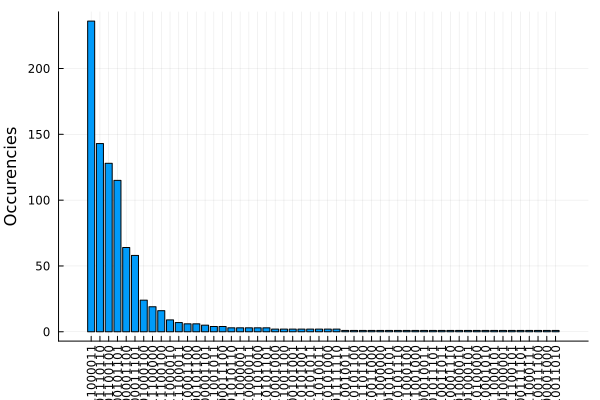

In [72]:
hidden_data6 = zeros(n_hidden6, data_shape[3])
for i in 1:data_shape[3]
    hidden_data6[:,i]=RestrictedBoltzmannMachines.sample_h_from_v(rbm6, hidden_data5[:,i]) 
end

using StatsBase: countmap
data_joined = [join(Int.(hidden_data6[:,i]), "") for i in 1:size(hidden_data6)[2]]
counts = countmap(data_joined)

indipkey = collect(keys(counts))
vals  = collect(values(counts))
order = sortperm(vals, rev=true) 
indipkey = indipkey[order]
vals = vals[order]

bar(1:length(vals), vals, legend=false)
xticks!(1:length(vals), indipkey, xrotation =90)
ylabel!("Occurencies")

In [73]:
codes =indipkey[1:6]

6-element Vector{String}:
 "11000011"
 "01110110"
 "01100100"
 "00101101"
 "00001100"
 "00011101"

In [148]:
code1 = [1,1,0,0,0,0,1,1]
code2 = [0,1,1,1,0,1,1,0]
code3 = [0,1,1,0,0,1,0,0]
code4 = [0,0,1,0,1,1,0,1]
code5 = [0,0,0,0,1,1,0,0]
code6 = [0,0,0,1,1,1,0,1]

codes = [code1, code2, code3, code4, code5, code6]

6-element Vector{Vector{Int64}}:
 [1, 1, 0, 0, 0, 0, 1, 1]
 [0, 1, 1, 1, 0, 1, 1, 0]
 [0, 1, 1, 0, 0, 1, 0, 0]
 [0, 0, 1, 0, 1, 1, 0, 1]
 [0, 0, 0, 0, 1, 1, 0, 0]
 [0, 0, 0, 1, 1, 1, 0, 1]

In [118]:
using RestrictedBoltzmannMachines: sample_h_from_v, sample_v_from_h
_, _, O_v = PCA(reshape(train_data, (data_shape[1]*data_shape[2], data_shape[3])))

function toggle_to_seq_pca_space(toggle_conf, Neq=1)
    v6 = sample_v_from_h(rbm6, toggle_conf)
    h5 = v6
    v5 = sample_v_from_h(rbm5, h5)
    h4 = v5 
    v4 = sample_v_from_h(rbm4, h4)
    h3 = v4 
    v3 = sample_v_from_h(rbm3, h3)
    h2 = v3
    v2 = sample_v_from_h(rbm2, h2)
    h1 = v2
    seq = sample_v_from_h(rbm1, h1)
    for i in 1:Neq
        htemp = sample_h_from_v(rbm1, seq)
        seq = sample_v_from_h(rbm1, htemp)
    end
    flat_seq = reshape(seq, data_shape[1]*data_shape[2])
    #rotate and get pcas

    rot_flat_seq = transpose(O_v)*flat_seq
    return [rot_flat_seq[end-i, :] for i in 0:3]
end


toggle_to_seq_pca_space (generic function with 2 methods)

In [149]:
Ndata = 500

data1=zeros(4, Ndata) 
data2=zeros(4, Ndata) 
data3=zeros(4, Ndata) 
data4=zeros(4, Ndata) 
data5=zeros(4, Ndata) 
data6=zeros(4, Ndata) 


for k in  1:Ndata
    data1[:,k] = reduce(vcat, toggle_to_seq_pca_space(code1))
    data2[:,k] = reduce(vcat, toggle_to_seq_pca_space(code2))
    data3[:,k] = reduce(vcat, toggle_to_seq_pca_space(code3))
    data4[:,k] = reduce(vcat, toggle_to_seq_pca_space(code4))
    data5[:,k] = reduce(vcat, toggle_to_seq_pca_space(code5))
    data6[:,k] = reduce(vcat, toggle_to_seq_pca_space(code6))
end

In [150]:
test_shape = size(test_data)
test_data_rot = transpose(O_v)*reshape(test_data, (test_shape[1]*test_shape[2], test_shape[3]))



pca_t = [test_data_rot[end-i, :] for i in 0:3];


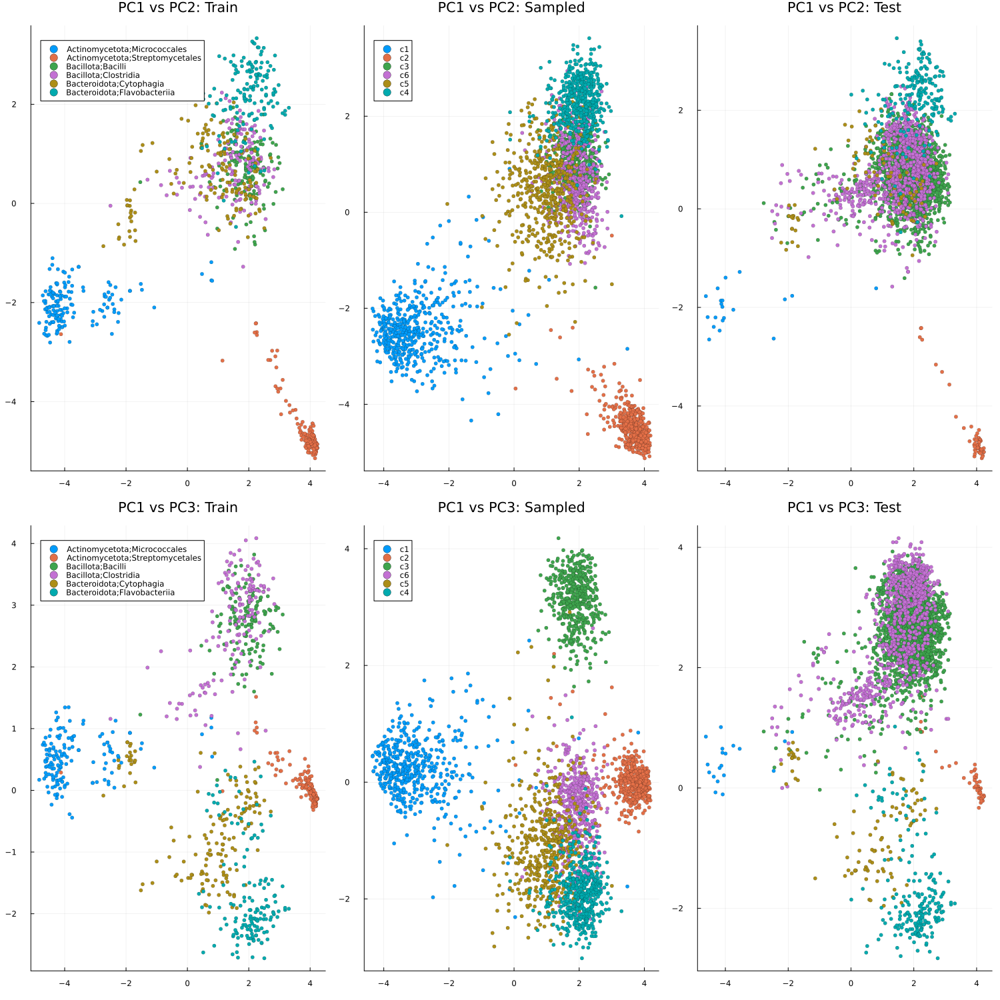

In [151]:
p1 = scatter(df_v.PC1, df_v.PC2, group=df_v.Label, markerstrokewidth=0.05, ms=3, markeralpha=1, title="PC1 vs PC2: Train")


p2 = scatter(data3[1,:], data3[2,:], label = "c1", markerstrokewidth=0.05, ms=3, title="PC1 vs PC2: Sampled")
scatter!(data2[1,:], data2[2,:], label = "c2",  markerstrokewidth=0.05, ms=3)
scatter!(data1[1,:], data1[2,:], label = "c3",  markerstrokewidth=0.05, ms=3)
scatter!(data6[1,:], data6[2,:], label = "c6",  markerstrokewidth=0.05, ms=3)
scatter!(data5[1,:], data5[2,:], label = "c5",  markerstrokewidth=0.05, ms=3)
scatter!(data4[1,:], data4[2,:], label = "c4",  markerstrokewidth=0.05, ms=3)

p3 = scatter(df_t.PC1, df_t.PC2, group=df_t.Label, markerstrokewidth=0.05, ms=3, markeralpha=1, title="PC1 vs PC2: Test",  legend=false)


p4 = scatter(df_v.PC1, df_v.PC3, group=df_v.Label, markerstrokewidth=0.05, ms=3, markeralpha=1, title="PC1 vs PC3: Train")


p5 = scatter(data3[1,:], data3[3,:], label = "c1", markerstrokewidth=0.05, ms=3, title="PC1 vs PC3: Sampled")
scatter!(data2[1,:], data2[3,:], label = "c2",  markerstrokewidth=0.05, ms=3)
scatter!(data1[1,:], data1[3,:], label = "c3",  markerstrokewidth=0.05, ms=3)
scatter!(data6[1,:], data6[3,:], label = "c6",  markerstrokewidth=0.05, ms=3)
scatter!(data5[1,:], data5[3,:], label = "c5",  markerstrokewidth=0.05, ms=3)
scatter!(data4[1,:], data4[3,:], label = "c4",  markerstrokewidth=0.05, ms=3)

p6 = scatter(df_t.PC1, df_t.PC3, group=df_t.Label, markerstrokewidth=0.05, ms=3, markeralpha=1, title="PC1 vs PC3: Test", legend=false)


plot(p1, p2, p3, p4, p5, p6, size = (1500,1500))


In [152]:
function seq_generator(code, Neq=1)
    v6 = sample_v_from_h(rbm6, code)
    h5 = v6
    v5 = sample_v_from_h(rbm5, h5)
    h4 = v5 
    v4 = sample_v_from_h(rbm4, h4)
    h3 = v4 
    v3 = sample_v_from_h(rbm3, h3)
    h2 = v3
    v2 = sample_v_from_h(rbm2, h2)
    h1 = v2
    seq = sample_v_from_h(rbm1, h1)
    seq = RBMs.sample_v_from_h(rbm1, h1)
    for i in 1:Neq
        h_temp = sample_h_from_v(rbm1, seq)
        seq = sample_v_from_h(rbm1, h_temp)
    end
    return seq
end

seq_generator (generic function with 2 methods)

In [153]:
Ndata = 1000

seq1=zeros(5, 108, Ndata)
seq2=zeros(5, 108, Ndata)
seq3=zeros(5, 108, Ndata)
seq4=zeros(5, 108, Ndata)
seq5=zeros(5, 108, Ndata)
seq6=zeros(5, 108, Ndata)


for k in  1:Ndata
    seq1[:,:,k] = seq_generator(codes[1])
    seq2[:,:,k] = seq_generator(codes[2])
    seq3[:,:,k] = seq_generator(codes[3])    
    seq4[:,:,k] = seq_generator(codes[4])
    seq5[:,:,k] = seq_generator(codes[5])    
    seq6[:,:,k] = seq_generator(codes[6])
end

# Sequence Logo Plot of the Clusters

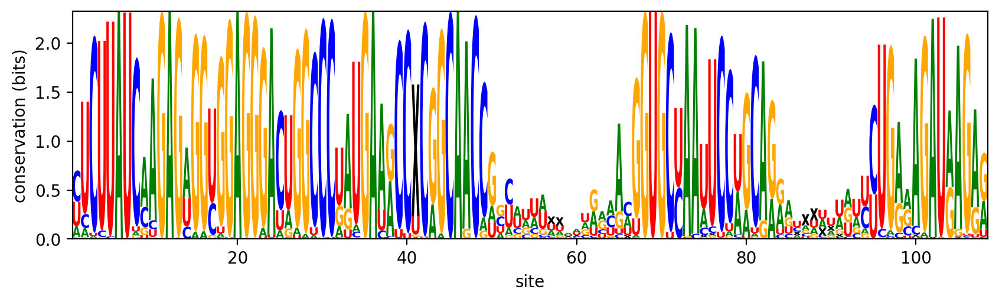

In [154]:
#c1
SamApp.seqlogo_entropic(reshape(mean(seq1; dims=3), 5, 108)).fig


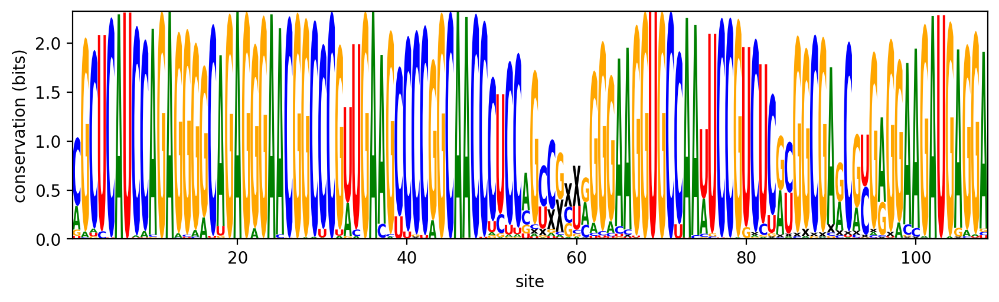

In [155]:
#c2 
SamApp.seqlogo_entropic(reshape(mean(seq2; dims=3), 5, 108)).fig

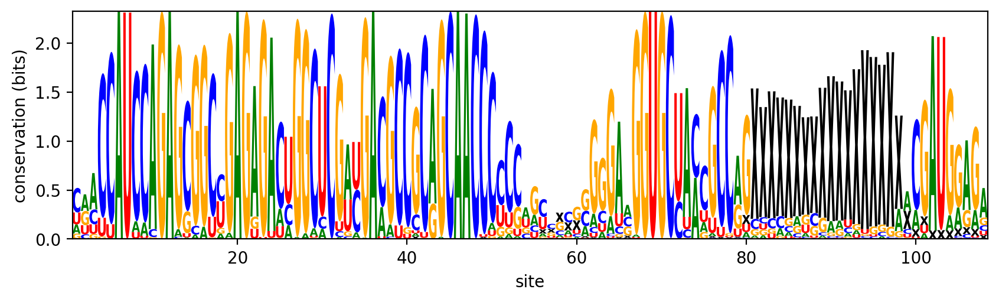

In [156]:
#c3
SamApp.seqlogo_entropic(reshape(mean(seq3; dims=3), 5, 108)).fig


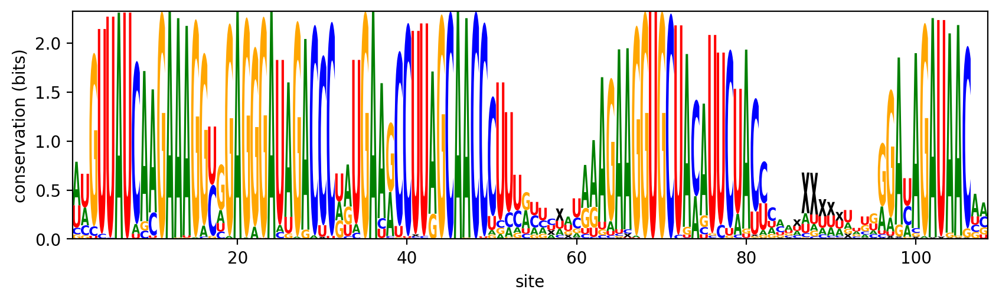

In [157]:
#c4
SamApp.seqlogo_entropic(reshape(mean(seq4; dims=3), 5, 108)).fig


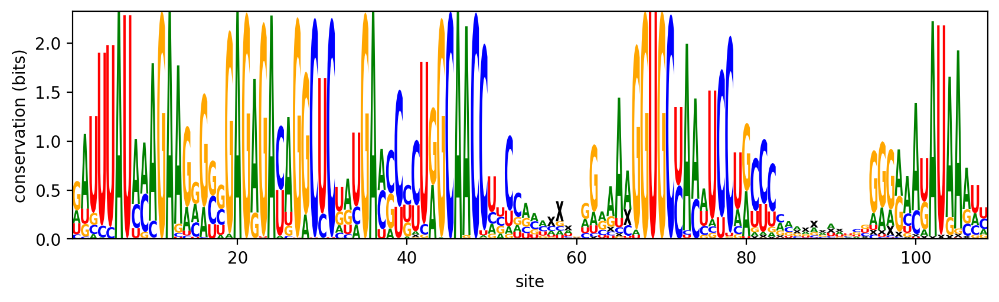

In [158]:
#c5
SamApp.seqlogo_entropic(reshape(mean(seq5; dims=3), 5, 108)).fig


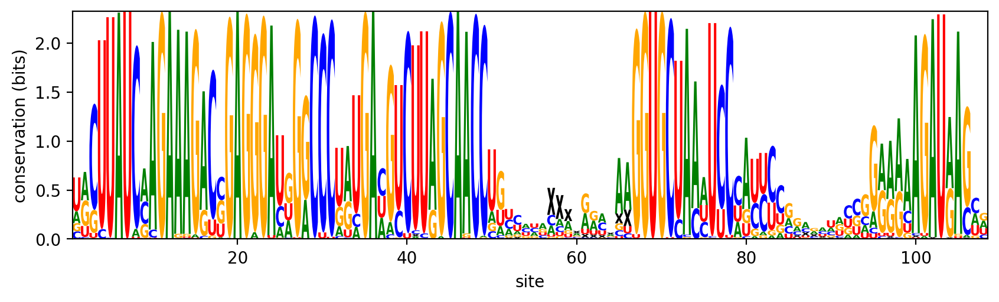

In [159]:
#c6
SamApp.seqlogo_entropic(reshape(mean(seq6; dims=3), 5, 108)).fig


# Score Distribution

In [160]:
rbm2022 = SamApp.rbm2022()
using RestrictedBoltzmannMachines: free_energy

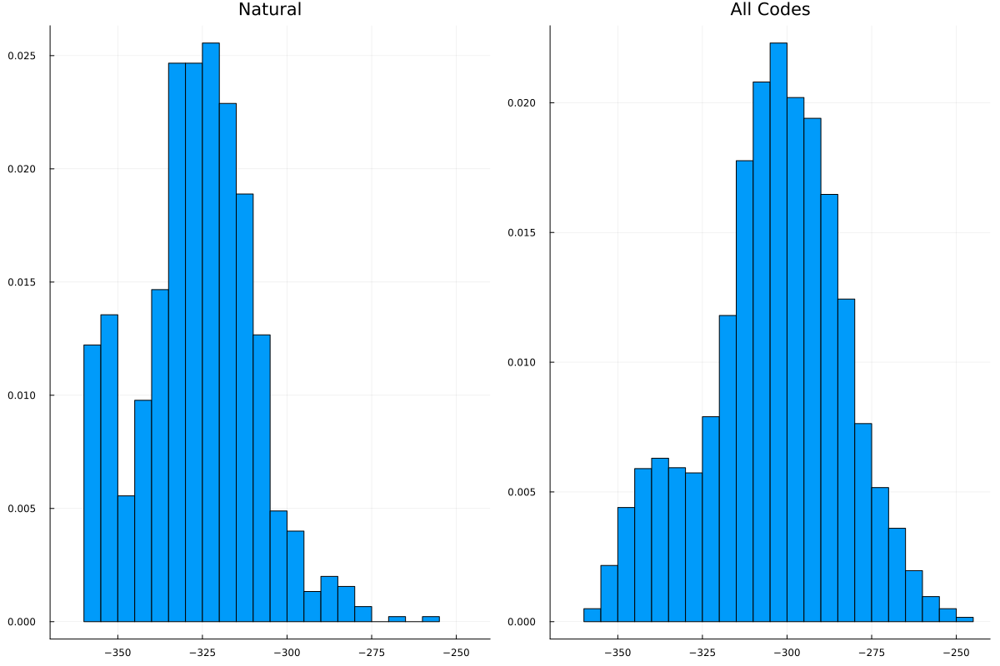

In [162]:
score_natural = [free_energy(rbm2022, train_data[:,:,i]) for i in 1:size(train_data)[3]]
score_1 = [free_energy(rbm2022,seq1[:,:,i]) for i in 1:Ndata]
score_2 = [free_energy(rbm2022,seq2[:,:,i]) for i in 1:Ndata]
score_3 = [free_energy(rbm2022,seq3[:,:,i]) for i in 1:Ndata]
score_4 = [free_energy(rbm2022,seq4[:,:,i]) for i in 1:Ndata]
score_5 = [free_energy(rbm2022,seq5[:,:,i]) for i in 1:Ndata]
score_6 = [free_energy(rbm2022,seq6[:,:,i]) for i in 1:Ndata]

p1=histogram(score_natural, normalize=:pdf, title= "Natural")
p2=histogram(vcat(score_1, score_2, score_3, score_4, score_5, score_6), normalize=:pdf, title= "All Codes")

plot(p1,p2,legend=false, size= (1200,800), xlims=(-370, -240))

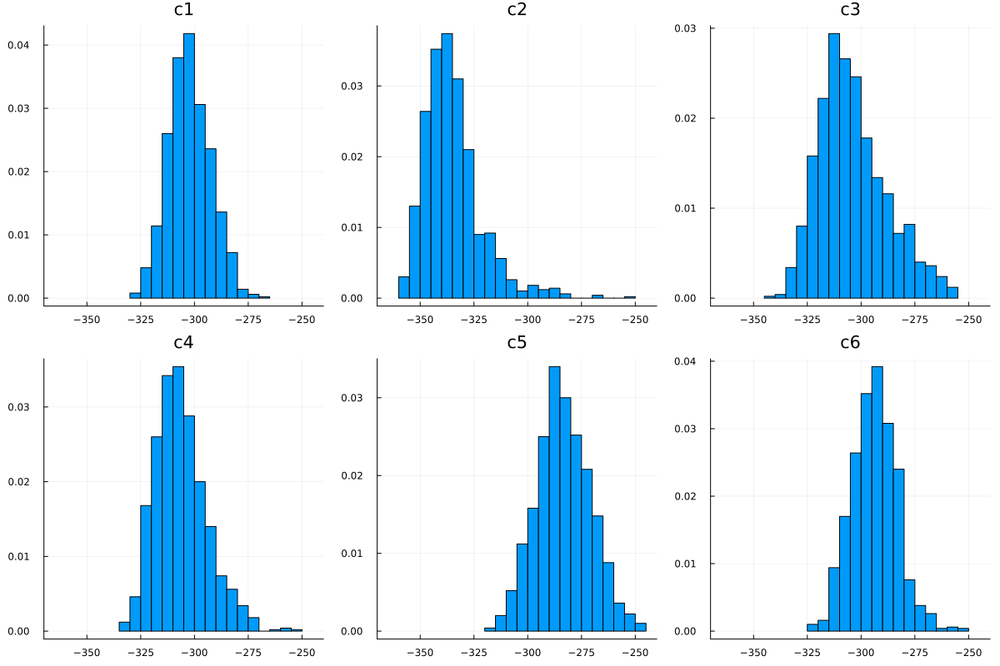

In [163]:
p1=histogram(score_1, normalize=:pdf, title= "c1")
p2=histogram(score_2, normalize=:pdf, title= "c2")
p3=histogram(score_3, normalize=:pdf, title= "c3")
p4=histogram(score_4, normalize=:pdf, title= "c4")
p5=histogram(score_5, normalize=:pdf, title= "c5")
p6=histogram(score_6, normalize=:pdf, title= "c6")


plot(p1,p2, p3, p4, p5, p6, legend=false, size= (1200,800), xlims=(-370, -240))